In [1]:
import nltk
from nltk.tokenize import word_tokenize
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score
from sklearn.feature_extraction.text import TfidfVectorizer
from wordcloud import WordCloud
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import requests
import json
import bz2

In [3]:
import numpy as np
import pandas as pd
import tensorflow as tf
import math
import matplotlib.pyplot as plt
from tensorflow import keras
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import train_test_split
from tensorflow import keras


In [4]:
# Define tu token
API_KEY = "83fa12351eb358493c952697bfa9cb7606427f817602e085b98382fafd05e72c"

# Definir la URL del servicio con el token incluido
service_url = f"http://data.phishtank.com/data/{API_KEY}/online-valid.json.bz2"

# Realizar una solicitud POST para obtener los datos en formato BZ2
response = requests.post(service_url)

# Verificar si la solicitud fue exitosa (código de estado 200)
if response.status_code == 200:
    # Descomprimir los datos BZ2
    compressed_data = response.content
    decompressed_data = bz2.decompress(compressed_data).decode('utf-8')

    # Convertir los datos JSON en un diccionario Python
    phishing_data = json.loads(decompressed_data)

    # Analizar y trabajar con los datos según sea necesario
    print(phishing_data)
else:
    print("Error al obtener los datos:", response.status_code)


[{'phish_id': 8579123, 'url': 'https://www.ipkablsneas.com/', 'phish_detail_url': 'http://www.phishtank.com/phish_detail.php?phish_id=8579123', 'submission_time': '2024-05-17T15:02:06+00:00', 'verified': 'yes', 'verification_time': '2024-05-17T15:13:39+00:00', 'online': 'yes', 'details': [{'ip_address': '172.67.157.145', 'cidr_block': '172.67.144.0/20', 'announcing_network': '13335', 'rir': 'arin', 'country': 'US', 'detail_time': '2024-05-17T15:13:09+00:00'}], 'target': 'Other'}, {'phish_id': 8579089, 'url': 'http://www.ipkublzneas.com/', 'phish_detail_url': 'http://www.phishtank.com/phish_detail.php?phish_id=8579089', 'submission_time': '2024-05-17T14:18:39+00:00', 'verified': 'yes', 'verification_time': '2024-05-17T14:53:12+00:00', 'online': 'yes', 'details': [{'ip_address': '172.67.172.46', 'cidr_block': '172.67.160.0/20', 'announcing_network': '13335', 'rir': 'arin', 'country': 'US', 'detail_time': '2024-05-17T14:43:14+00:00'}], 'target': 'Other'}, {'phish_id': 8579090, 'url': 'htt

In [7]:
df=pd.DataFrame(phishing_data)
df

,phish_id,url,phish_detail_url,submission_time,verified,verification_time,online,details,target
0,8579123,https://www.ipkablsneas.com/,http://www.phishtank.com/phish_detail.php?phis...,2024-05-17T15:02:06+00:00,yes,2024-05-17T15:13:39+00:00,yes,"[{'ip_address': '172.67.157.145', 'cidr_block'...",Other
1,8579089,http://www.ipkublzneas.com/,http://www.phishtank.com/phish_detail.php?phis...,2024-05-17T14:18:39+00:00,yes,2024-05-17T14:53:12+00:00,yes,"[{'ip_address': '172.67.172.46', 'cidr_block':...",Other
2,8579090,https://www.ipkublzneas.com/,http://www.phishtank.com/phish_detail.php?phis...,2024-05-17T14:18:39+00:00,yes,2024-05-17T14:53:12+00:00,yes,"[{'ip_address': '172.67.172.46', 'cidr_block':...",Other
3,8578298,https://banruralgt.muvit.travel,http://www.phishtank.com/phish_detail.php?phis...,2024-05-16T18:40:48+00:00,yes,2024-05-16T20:13:35+00:00,yes,"[{'ip_address': '34.49.230.65', 'cidr_block': ...",Other
4,8578254,https://vtlearn.net/signin,http://www.phishtank.com/phish_detail.php?phis...,2024-05-16T18:00:42+00:00,yes,2024-05-16T20:13:35+00:00,yes,"[{'ip_address': '108.167.165.117', 'cidr_block...",Other
...,...,...,...,...,...,...,...,...,...
60125,3573703,http://www.ezblox.site/free/jennifer111/helpdesk,http://www.phishtank.com/phish_detail.php?phis...,2015-11-03T14:41:38+00:00,yes,2016-03-15T18:51:08+00:00,yes,"[{'ip_address': '74.125.25.121', 'cidr_block':...",Other
60126,2042606,http://www.formbuddy.com/cgi-bin/formdisp.pl?u...,http://www.phishtank.com/phish_detail.php?phis...,2013-09-30T13:24:39+00:00,yes,2013-10-01T13:33:17+00:00,yes,"[{'ip_address': '67.222.1.10', 'cidr_block': '...",Other
60127,1865971,http://www.formbuddy.com/cgi-bin/formdisp.pl?u...,http://www.phishtank.com/phish_detail.php?phis...,2013-05-28T15:59:31+00:00,yes,2013-05-28T22:13:12+00:00,yes,"[{'ip_address': '67.222.1.10', 'cidr_block': '...",Other
60128,1460953,http://www.habbocreditosparati.blogspot.com/,http://www.phishtank.com/phish_detail.php?phis...,2012-06-14T15:19:26+00:00,yes,2012-06-14T15:29:11+00:00,yes,"[{'ip_address': '74.125.224.43', 'cidr_block':...",Sulake Corporation


In [15]:
df_cleaned=df.iloc[:,0:2]
df_cleaned

,phish_id,url
0,8579123,https://www.ipkablsneas.com/
1,8579089,http://www.ipkublzneas.com/
2,8579090,https://www.ipkublzneas.com/
3,8578298,https://banruralgt.muvit.travel
4,8578254,https://vtlearn.net/signin
...,...,...
60125,3573703,http://www.ezblox.site/free/jennifer111/helpdesk
60126,2042606,http://www.formbuddy.com/cgi-bin/formdisp.pl?u...
60127,1865971,http://www.formbuddy.com/cgi-bin/formdisp.pl?u...
60128,1460953,http://www.habbocreditosparati.blogspot.com/


In [16]:
tokenizer = Tokenizer(num_words=500)
tokenizer.fit_on_texts(df_cleaned["url"])

In [18]:
df_cleaned['text sequences']=tokenizer.texts_to_sequences(df_cleaned['url'])

In [19]:
df_cleaned['text sequences_length']=df_cleaned['text sequences'].apply(lambda t: len(t))

In [20]:
df_cleaned.head()

,phish_id,url,text sequences,text sequences_length
0,8579123,https://www.ipkablsneas.com/,"[1, 36, 2]",3
1,8579089,http://www.ipkublzneas.com/,"[9, 36, 2]",3
2,8579090,https://www.ipkublzneas.com/,"[1, 36, 2]",3
3,8578298,https://banruralgt.muvit.travel,[1],1
4,8578254,https://vtlearn.net/signin,"[1, 63, 99]",3


In [22]:
X = pad_sequences(df_cleaned["text sequences"], maxlen=max(df_cleaned["text sequences_length"]))

In [23]:
df_x= pd.DataFrame(X)

In [28]:
df_x.shape[0]

60130

In [35]:
df_x['label']=np.ones(df_x.shape[0])
df_x.head()

,0,1,2,3,4,5,6,7,8,9,...,324,325,326,327,328,329,330,331,332,label
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,36,2,1.0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,9,36,2,1.0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,36,2,1.0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,1.0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,63,99,1.0


In [36]:
y=df_x['label']
X=df_x.drop(columns='label')

In [37]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [40]:
from sklearn.decomposition import PCA
n_components=50
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

In [41]:
pca.explained_variance_ratio_.cumsum()

array([0.2622894 , 0.41402033, 0.5373488 , 0.6485709 , 0.72392546,
       0.76509241, 0.8003091 , 0.82551833, 0.84569653, 0.8625178 ,
       0.87812122, 0.89138723, 0.90309114, 0.91370345, 0.92192254,
       0.92882809, 0.93558978, 0.94133438, 0.94644357, 0.95123582,
       0.95502925, 0.9586934 , 0.96201447, 0.96528908, 0.96806034,
       0.97067126, 0.97314077, 0.97551317, 0.97772972, 0.9796028 ,
       0.9813728 , 0.98298222, 0.98447876, 0.98594697, 0.98732082,
       0.98858572, 0.98983137, 0.99101631, 0.99210995, 0.9930353 ,
       0.99387278, 0.99465214, 0.99535198, 0.99600214, 0.99657365,
       0.99709989, 0.99756008, 0.99798861, 0.99836341, 0.99872796])

In [43]:
n_features=50

In [44]:
model = Sequential()
model.add(Dense(64, activation='relu', kernel_initializer='he_normal', input_shape=(n_features,)))
model.add(Dense(64, activation='relu', kernel_initializer='he_normal'))
model.add(Dense(1, activation='sigmoid'))

d:\danie\anaconda3\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [45]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [46]:
loss_per_epoch=[]
accuracy_per_epoch=[]
num_epochs=15

for epoch in range(num_epochs):
    # Entrenamiento por época
    history = model.fit(
      X_train_pca,y_train,epochs=1
    )

    # Almacenar la pérdida y la métrica (precisión en este caso) por época
    loss_per_epoch.append(history.history['loss'][0])
    accuracy_per_epoch.append(history.history['accuracy'][0])

1504/1504 ━━━━━━━━━━━━━━━━━━━━ 12s 2ms/step - accuracy: 0.9717 - loss: 0.4726
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 1.5313e-06
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 1.1429e-07
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 2.3021e-08
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 1.2893e-08
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 4.7114e-09
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 3.4322e-09
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - accuracy: 1.0000 - loss: 2.8896e-09
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 7.8960e-10
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 5.7487e-10
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 5.2237e-10
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 1.0000 - loss: 3.2459e-10
1504/1504 ━━━━━━━━━━━━━━━━━━━━ 

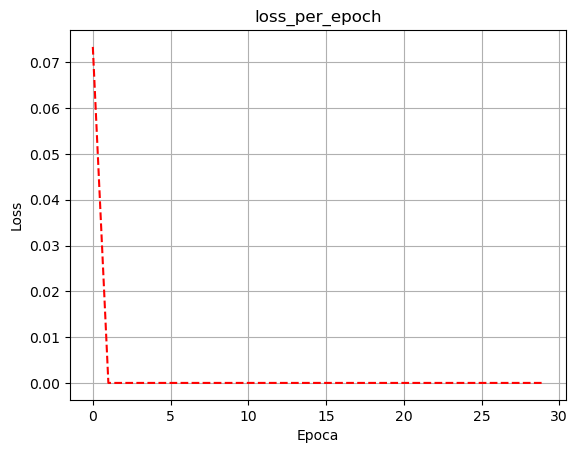

In [47]:
plt.xlabel('Epoca')
plt.ylabel('Loss')
plt.title('loss_per_epoch')
plt.grid(True)
plt.plot(loss_per_epoch,'r--')

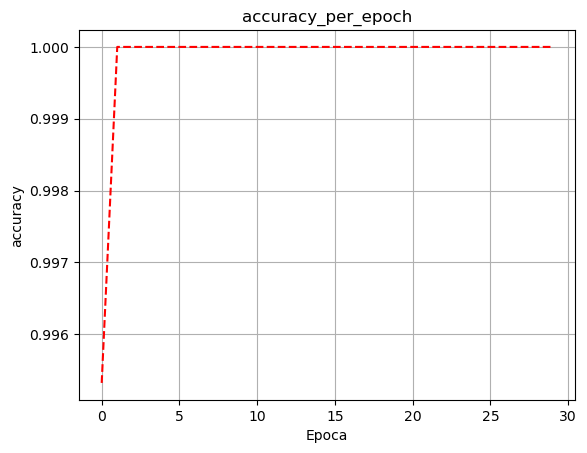

In [48]:
plt.xlabel('Epoca')
plt.ylabel('accuracy')
plt.title('accuracy_per_epoch')
plt.grid(True)
plt.plot(accuracy_per_epoch,'r--')